# 2.Exploratory Data Analysis (EDA)

### Import relevent Libaries

In [1]:
#pip install folium


In [2]:
#pip install plotly


In [3]:
#pip install matplotlib

In [4]:
#pip install pandas==1.2.5

In [5]:
#pip install --upgrade pandas

In [6]:
#pip install seaborn --upgrade

In [7]:
#pip install daal==2021.2.3

In [8]:
#pip install ydata-profiling --upgrade

In [9]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale

import folium
import geopandas as gpd
from shapely.geometry import Point
from geopy.distance import geodesic
from geopy.geocoders import Nominatim
import math
from math import radians, sin, cos, sqrt, atan2
import plotly.graph_objects as go

from sklearn.cluster import AgglomerativeClustering as AC

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


### Source and load the data

In [10]:
cleanfilepath = "../data/interim/cleaned_crime_data.csv"
crimedata = pd.read_csv(cleanfilepath,index_col =0)

#### Crime data from 2010 to 2022

In [11]:
crimedata.head(3)

,DATE_OCC,TIME_OCC,AREA,AREA_NAME,CRM_CD,CRM_CD_DESC,VICT_AGE,VICT_SEX,VICT_DESCENT,latitude,longitude,MTH_OCC,DAY_OCC,YEAR_OCC,WEEKDAY_OCC_ID,WEEKDAY_OCC,TIME_OCC_TYPE_ID,TIME_OCC_TYPE
index,,,,,,,,,,,,,,,,,,
0,2010-02-20,1350,13,Newton,900,VIOLATION OF COURT ORDER,48,M,Hispanic/Latin/Mexican,33.9825,-118.2695,2,20,2010,5,Saturday,1,PM
1,2010-09-12,45,14,Pacific,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",0,M,White,33.9599,-118.3962,9,12,2010,6,Sunday,1,PM
2,2010-08-09,1515,13,Newton,946,OTHER MISCELLANEOUS CRIME,0,M,Hispanic/Latin/Mexican,34.0224,-118.2524,8,9,2010,0,Monday,1,PM


In [12]:
crimedata.dtypes

DATE_OCC             object
TIME_OCC              int64
AREA                  int64
AREA_NAME            object
CRM_CD                int64
CRM_CD_DESC          object
VICT_AGE              int64
VICT_SEX             object
VICT_DESCENT         object
latitude            float64
longitude           float64
MTH_OCC               int64
DAY_OCC               int64
YEAR_OCC              int64
WEEKDAY_OCC_ID        int64
WEEKDAY_OCC          object
TIME_OCC_TYPE_ID      int64
TIME_OCC_TYPE        object
dtype: object

In [13]:
crimedata.describe()

,TIME_OCC,AREA,CRM_CD,VICT_AGE,latitude,longitude,MTH_OCC,DAY_OCC,YEAR_OCC,WEEKDAY_OCC_ID,TIME_OCC_TYPE_ID
count,2.707190e+06,2.707190e+06,2.707190e+06,2.707190e+06,2.707190e+06,2.707190e+06,2.707190e+06,2.707190e+06,2.707190e+06,2.707190e+06,2.707190e+06
mean,1.353549e+03,1.088619e+01,5.058155e+02,3.142259e+01,3.403785e+01,-1.182224e+02,6.518592e+00,1.546584e+01,2.016161e+03,3.009549e+00,8.751946e-01
std,6.488347e+02,5.990478e+00,2.101430e+02,2.088543e+01,1.155565e+00,3.995181e+00,3.431711e+00,8.936940e+00,3.749989e+00,1.988335e+00,3.304982e-01
min,1.000000e+00,1.000000e+00,1.100000e+02,0.000000e+00,0.000000e+00,-1.188279e+02,1.000000e+00,1.000000e+00,2.010000e+03,0.000000e+00,0.000000e+00
25%,9.200000e+02,6.000000e+00,3.300000e+02,1.900000e+01,3.401090e+01,-1.184336e+02,4.000000e+00,8.000000e+00,2.013000e+03,1.000000e+00,1.000000e+00
50%,1.430000e+03,1.100000e+01,4.420000e+02,3.100000e+01,3.406130e+01,-1.183277e+02,7.000000e+00,1.500000e+01,2.016000e+03,3.000000e+00,1.000000e+00
75%,1.900000e+03,1.600000e+01,6.260000e+02,4.600000e+01,3.417200e+01,-1.182765e+02,9.000000e+00,2.300000e+01,2.019000e+03,5.000000e+00,1.000000e+00
max,2.359000e+03,2.100000e+01,9.560000e+02,1.200000e+02,3.479070e+01,0.000000e+00,1.200000e+01,3.100000e+01,2.022000e+03,6.000000e+00,1.000000e+00


In [14]:
crimedata.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2707190 entries, 0 to 2780203
Data columns (total 18 columns):
 #   Column            Dtype  
---  ------            -----  
 0   DATE_OCC          object 
 1   TIME_OCC          int64  
 2   AREA              int64  
 3   AREA_NAME         object 
 4   CRM_CD            int64  
 5   CRM_CD_DESC       object 
 6   VICT_AGE          int64  
 7   VICT_SEX          object 
 8   VICT_DESCENT      object 
 9   latitude          float64
 10  longitude         float64
 11  MTH_OCC           int64  
 12  DAY_OCC           int64  
 13  YEAR_OCC          int64  
 14  WEEKDAY_OCC_ID    int64  
 15  WEEKDAY_OCC       object 
 16  TIME_OCC_TYPE_ID  int64  
 17  TIME_OCC_TYPE     object 
dtypes: float64(2), int64(9), object(7)
memory usage: 392.4+ MB


In [15]:
crimedata.shape

(2707190, 18)

In [16]:
# Check for missing values
missing_data = crimedata.isnull().sum()
print(missing_data)

# Check for duplicates
duplicates = crimedata.duplicated().sum()
print(duplicates)


DATE_OCC                 0
TIME_OCC                 0
AREA                     0
AREA_NAME                0
CRM_CD                   0
CRM_CD_DESC              0
VICT_AGE                 0
VICT_SEX                 0
VICT_DESCENT        274109
latitude                 0
longitude                0
MTH_OCC                  0
DAY_OCC                  0
YEAR_OCC                 0
WEEKDAY_OCC_ID           0
WEEKDAY_OCC              0
TIME_OCC_TYPE_ID         0
TIME_OCC_TYPE            0
dtype: int64
0


### 2.Explore The Data

<b>Data variable to explore :
</br>
Occurance Date/Time of the crime incident</br>
the day of the week</br>
detailed description of the crime incident</br>
AREA - the name of the Police Department District Area</br>
Longitude</br>
Latitude</br>
Victim Characteristics </br>
</b>

#### 2.1.Date Occurance & Day of the week

<b>What day of the week is the most crime incidents happened ?</b>

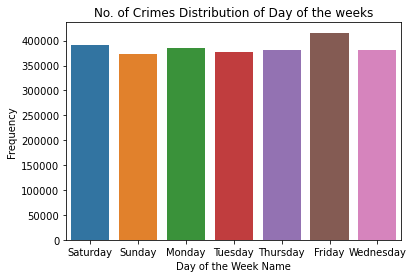

In [17]:


sns.countplot(data=crimedata, x='WEEKDAY_OCC')

plt.xlabel('Day of the Week Name')
plt.ylabel('Frequency')
plt.title('No. of Crimes Distribution of Day of the weeks')
plt.show()

In [18]:
print(crimedata['WEEKDAY_OCC'].value_counts())

Friday       415950
Saturday     390957
Monday       385303
Wednesday    382078
Thursday     381652
Tuesday      377555
Sunday       373695
Name: WEEKDAY_OCC, dtype: int64


Over past 12 years, Friday is the highest crime incidents happened followed by Saturday. On the other hand,Sunday is the least crimes happened.

 <b>What period of the day  is the most crime incidents happened ?</b>

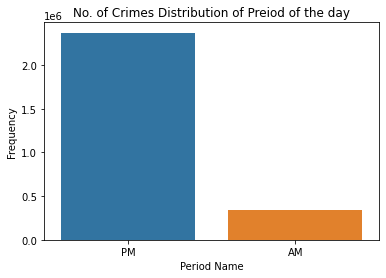

In [19]:

sns.countplot(data=crimedata, x='TIME_OCC_TYPE')

plt.xlabel('Period Name')
plt.ylabel('Frequency')
plt.title('No. of Crimes Distribution of Preiod of the day')
plt.show()

In [20]:
print(crimedata['TIME_OCC_TYPE'].value_counts())

PM    2369318
AM     337872
Name: TIME_OCC_TYPE, dtype: int64


Over past 12 years, During evening time (PM) is the highest crime incidents happened.

<b>What months have the most of the crimes recorded on average ?</b>

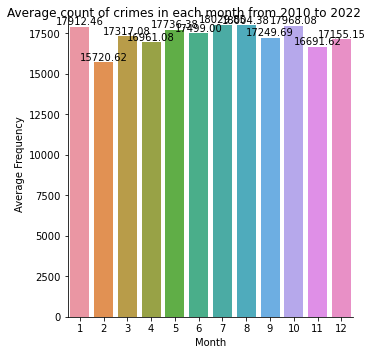

In [21]:

grouped_data = crimedata.groupby(['YEAR_OCC', 'MTH_OCC']).size().reset_index(name='Counts')
avg_monthly_counts = grouped_data.groupby('MTH_OCC')['Counts'].mean().reset_index()

# Create a Seaborn catplot
g = sns.catplot(x='MTH_OCC', y='Counts', data=avg_monthly_counts, kind='bar')

# Annotate each bar with its value
for ax in g.axes.flat:
    for patch in ax.patches:
        ax.annotate(f"{patch.get_height():.2f}", 
                    (patch.get_x() + patch.get_width() / 2., patch.get_height()), 
                    ha='center', va='center', 
                    xytext=(0, 5), 
                    textcoords='offset points')

g.set_xticklabels(range(1, 13))
g.set_axis_labels('Month', 'Average Frequency')
g.fig.suptitle('Average count of crimes in each month from 2010 to 2022')
plt.show()

In [22]:
print(crimedata['MTH_OCC'].value_counts())

7     234388
8     234057
10    233585
1     232862
5     230573
6     227487
3     225122
9     224246
12    223017
4     220494
11    216991
2     204368
Name: MTH_OCC, dtype: int64


Over 12 years, January is the highest crime rage on average.

<b>What year have the most of the crimes recorded?</b>

2022 has highest crime rate over 12 years

In [23]:
print(crimedata['YEAR_OCC'].value_counts())

2022    233284
2017    230657
2018    228710
2016    225020
2019    217754
2015    214984
2021    208441
2010    208324
2012    200976
2011    199914
2020    198329
2013    192052
2014    148745
Name: YEAR_OCC, dtype: int64


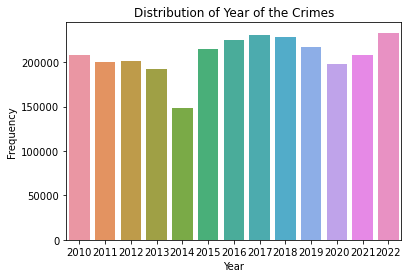

In [24]:
sns.countplot(data=crimedata, x='YEAR_OCC', order=range(2010, 2023))

plt.xlabel('Year')
plt.ylabel('Frequency')
plt.title('Distribution of Year of the Crimes')
plt.show()

<b>2.2 Victim characteristics</b>

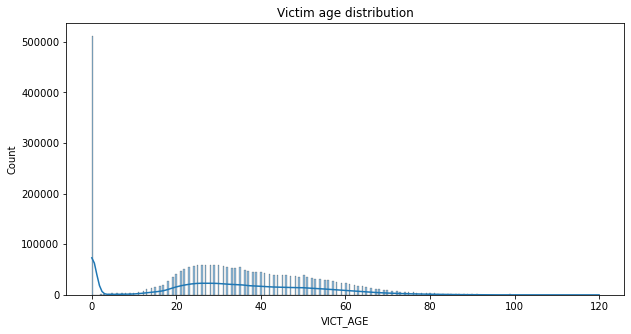

In [25]:
plt.figure(figsize=(10,5))
sns.histplot(crimedata['VICT_AGE'], kde=True)
plt.title('Victim age distribution')
plt.show()

In [26]:
print(crimedata['VICT_AGE'].value_counts())

0      511430
25      59765
26      59558
28      59480
27      59366
        ...  
96        245
97        213
98        164
118         1
120         1
Name: VICT_AGE, Length: 102, dtype: int64


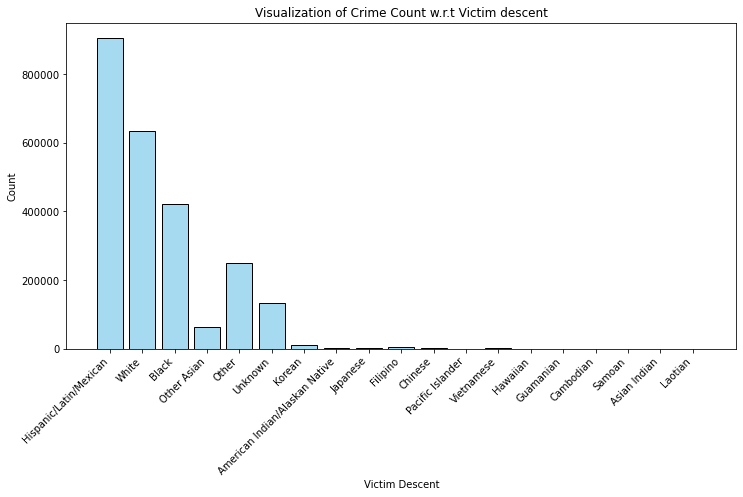

In [27]:
plt.figure(figsize=(12, 6))
sns.histplot(crimedata, x="VICT_DESCENT", color='skyblue', shrink=0.8)
plt.title("Visualization of Crime Count w.r.t Victim descent")
plt.xlabel("Victim Descent")
plt.ylabel("Count")
plt.xticks(rotation=45, ha='right')  
plt.show()

In [28]:
print(crimedata['VICT_DESCENT'].value_counts())

Hispanic/Latin/Mexican            905099
White                             635380
Black                             420585
Other                             248947
Unknown                           133675
Other Asian                        63880
Korean                             11803
Filipino                            5132
Chinese                             3374
American Indian/Alaskan Native      1531
Japanese                            1261
Vietnamese                           843
Pacific Islander                     514
Asian Indian                         445
Hawaiian                             292
Guamanian                            130
Cambodian                             68
Samoan                                66
Laotian                               56
Name: VICT_DESCENT, dtype: int64


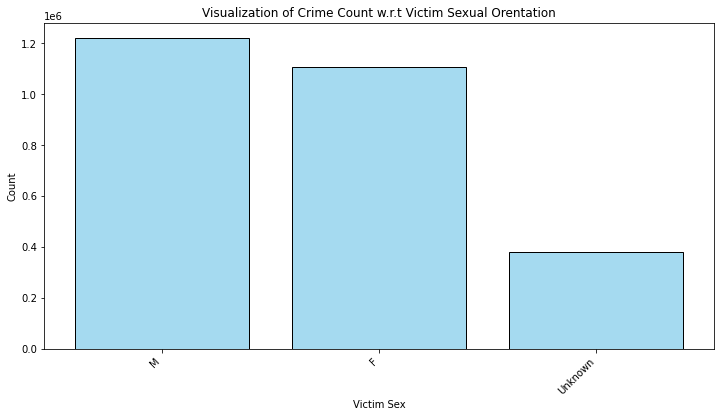

In [29]:
plt.figure(figsize=(12, 6))
sns.histplot(crimedata, x="VICT_SEX", color='skyblue', shrink=0.8)
plt.title("Visualization of Crime Count w.r.t Victim Sexual Orentation")
plt.xlabel("Victim Sex")
plt.ylabel("Count")
plt.xticks(rotation=45, ha='right')  
plt.show()

In [30]:
print(crimedata['VICT_SEX'].value_counts())

M          1219062
F          1107835
Unknown     380293
Name: VICT_SEX, dtype: int64


#### 2.2.the crime incident description

In [31]:
#crimedata['CRM_CD_DESC'].unique()
print(crimedata['CRM_CD_DESC'].value_counts())

BATTERY - SIMPLE ASSAULT                                   236262
VEHICLE - STOLEN                                           223696
BURGLARY FROM VEHICLE                                      199956
BURGLARY                                                   182891
THEFT PLAIN - PETTY ($950 & UNDER)                         180188
                                                            ...  
TILL TAP - ATTEMPT                                              4
FIREARMS EMERGENCY PROTECTIVE ORDER (FIREARMS EPO)              4
TRAIN WRECKING                                                  2
FIREARMS TEMPORARY RESTRAINING ORDER (TEMP FIREARMS RO)         1
DRUNK ROLL - ATTEMPT                                            1
Name: CRM_CD_DESC, Length: 143, dtype: int64


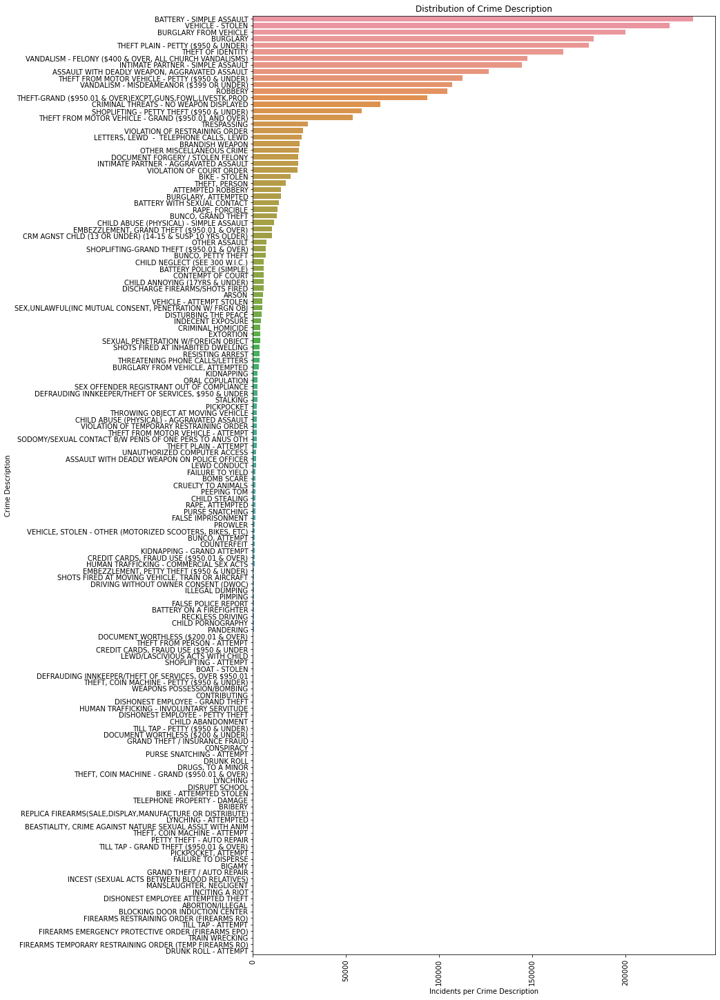

In [32]:
# Countplot for a categorical variable (e.g., description of crime)
plt.figure(figsize=(12, 25))  # Adjust the width (10) and height (20) as needed
sns.countplot(data=crimedata, y='CRM_CD_DESC',orient="h",order=crimedata['CRM_CD_DESC'].value_counts().index)

plt.xticks(rotation=90)
plt.ylabel('Crime Description')
plt.xlabel('Incidents per Crime Description')
plt.title('Distribution of Crime Description')
plt.show()

<b>Lets take a closer look with polar diagram on the 5 most common crimes over 12 years (2010 to 2022)</b>

In [33]:

fig = go.Figure(data=go.Scatterpolar(
  r=crimedata['CRM_CD_DESC'].value_counts().head(5),
  theta=crimedata['CRM_CD_DESC'].value_counts().head(5).index,
  fill='toself'
))

fig.update_layout(
    polar=dict(
        radialaxis=dict(
        visible=True
     ),
    ),
    showlegend=False,
    title_text="Top 5 LA Crime Record Radar Chart by Crime Desription",
    autosize=True
)

fig.show()

It appears that the most common type of is associated with assult, followed by theif and burglary.

In [34]:

# Identify top 5 most frequent values in colA
top_5_values = crimedata['CRM_CD_DESC'].value_counts().head(5).index

# Filter the original DataFrame
top_5_crimes = crimedata[crimedata['CRM_CD_DESC'].isin(top_5_values)]

# Reset index if needed
top_5_crimes = top_5_crimes.reset_index(drop=True)
# Add index+1 as ID column
top_5_crimes['ID'] = top_5_crimes.index + 1

print(top_5_crimes.head(1))
top_5_crimes.shape



     DATE_OCC  TIME_OCC  AREA AREA_NAME  CRM_CD            CRM_CD_DESC  \
0  2010-01-07      2005     1   Central     330  BURGLARY FROM VEHICLE   

   VICT_AGE VICT_SEX            VICT_DESCENT  latitude  longitude  MTH_OCC  \
0        46        M  Hispanic/Latin/Mexican   34.0389  -118.2643        1   

   DAY_OCC  YEAR_OCC  WEEKDAY_OCC_ID WEEKDAY_OCC  TIME_OCC_TYPE_ID  \
0        7      2010               3    Thursday                 1   

  TIME_OCC_TYPE  ID  
0            PM   1  


(1022993, 19)

In [35]:
top_5_crimes.head().T

,0,1,2,3,4
DATE_OCC,2010-01-07,2010-01-14,2010-01-29,2010-01-31,2010-01-31
TIME_OCC,2005,1445,1630,130,1000
AREA,1,1,1,1,1
AREA_NAME,Central,Central,Central,Central,Central
CRM_CD,330,624,330,440,624
CRM_CD_DESC,BURGLARY FROM VEHICLE,BATTERY - SIMPLE ASSAULT,BURGLARY FROM VEHICLE,THEFT PLAIN - PETTY ($950 & UNDER),BATTERY - SIMPLE ASSAULT
VICT_AGE,46,38,25,31,36
VICT_SEX,M,F,F,M,F
VICT_DESCENT,Hispanic/Latin/Mexican,Black,White,Hispanic/Latin/Mexican,Hispanic/Latin/Mexican
latitude,34.0389,34.064,34.0454,34.0472,34.0382


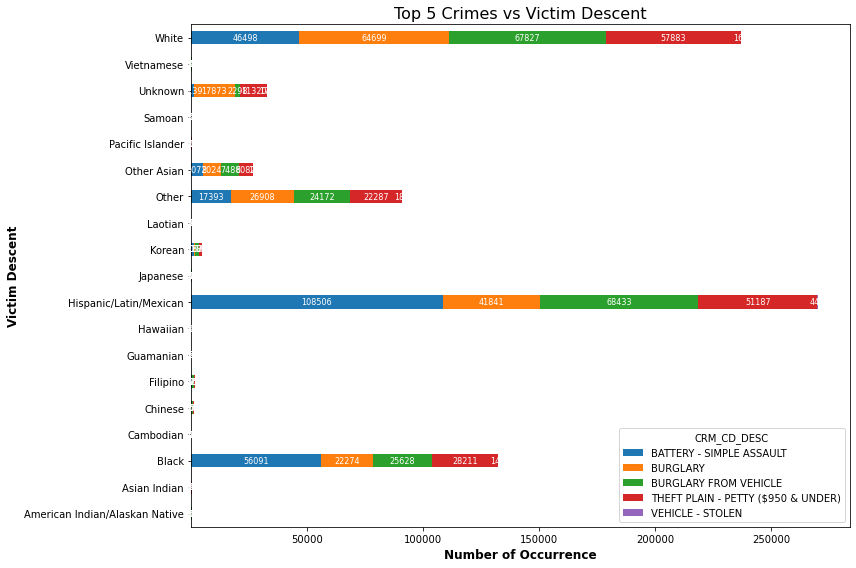

In [36]:

crime_type_by_DESCENT = top_5_crimes.groupby(['VICT_DESCENT', 'CRM_CD_DESC']).count().sort_values(by="ID", ascending=False)

crime_type_by_DESCENT = crime_type_by_DESCENT.reset_index()

pivot_table = crime_type_by_DESCENT.pivot(index='VICT_DESCENT', columns='CRM_CD_DESC', values='ID')

# Plot the horizontal bar chart
ax = pivot_table.plot(kind='barh', stacked=True, figsize=(12, 8))

# Annotate the bars with counts
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{int(width)}', (x + width/2, y + height/2), ha='center', va='center', fontsize=8, color='white')

plt.xlabel('Number of Occurrence', fontsize=12, fontweight='bold')
plt.ylabel('Victim Descent', fontsize=12, fontweight='bold')
plt.title('Top 5 Crimes vs Victim Descent', fontsize=16)
plt.tight_layout()

plt.show()

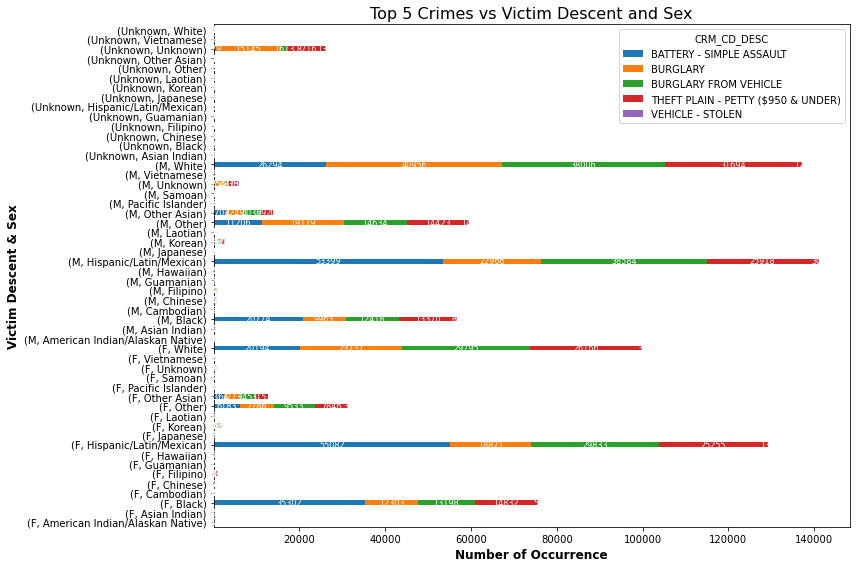

In [37]:

crime_type_by_DESCENTSEX = top_5_crimes.groupby(['VICT_SEX', 'VICT_DESCENT', 'CRM_CD_DESC']).count().sort_values(by="ID", ascending=False)
crime_type_by_DESCENTSEX  = crime_type_by_DESCENTSEX .reset_index()
pivot_table = crime_type_by_DESCENTSEX .pivot_table(index=['VICT_SEX', 'VICT_DESCENT'], columns=['CRM_CD_DESC'], values='ID', aggfunc='sum')

ax = pivot_table.plot(kind='barh', stacked=True, figsize=(12, 8))

# Annotate the bars with counts
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{int(width)}', (x + width/2, y + height/2), ha='center', va='center', fontsize=8, color='white')

plt.xlabel('Number of Occurrence', fontsize=12, fontweight='bold')
plt.ylabel('Victim Descent & Sex', fontsize=12, fontweight='bold')
plt.title('Top 5 Crimes vs Victim Descent and Sex', fontsize=16)
plt.tight_layout()

plt.show()

Below graphs indicate the average number of incidents happened by years and day of the week for top 5 crimes. It shows that different crimes have different frequency at the different timing. 

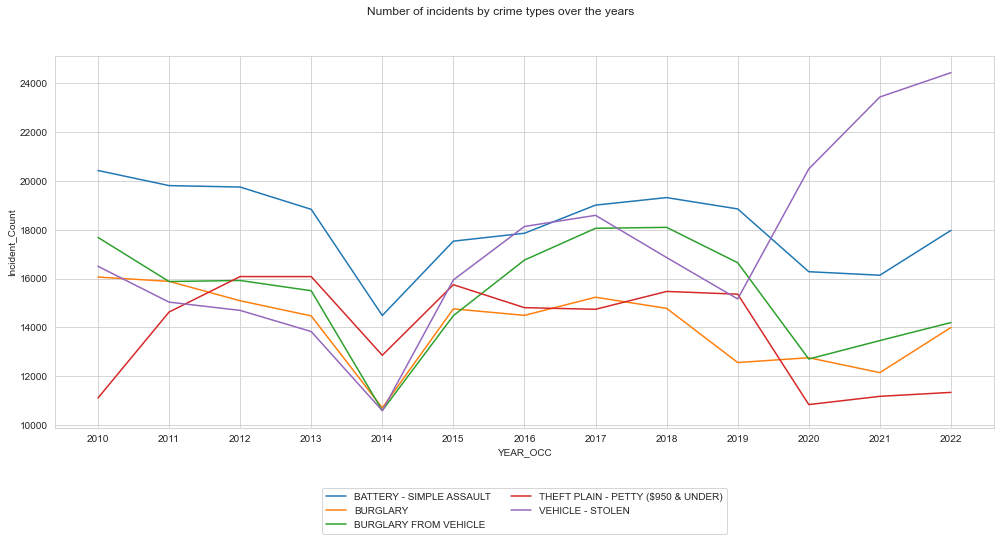

In [38]:

data_yearvscrimes = top_5_crimes.groupby(['YEAR_OCC', 'CRM_CD_DESC']).size().reset_index(name='Incident_Count')

sns.set_style("whitegrid")
fig, ax = plt.subplots(figsize=(14, 8))

# Plotting the Incident_Count over years for each crime description
ax = sns.lineplot(x='YEAR_OCC', y='Incident_Count', data=data_yearvscrimes, hue='CRM_CD_DESC')

# Assuming that 'YEAR_OCC' has year values, you wouldn't set crime descriptions as x-tick labels.
# Instead, handle the legend to avoid label cluttering.
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2) 
# Setting xticks from 2010 to 2022
ax.set_xticks(list(range(2010, 2023)))
ax.set_xticklabels(list(range(2010, 2023)))

plt.suptitle('Number of incidents by crime types over the years')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

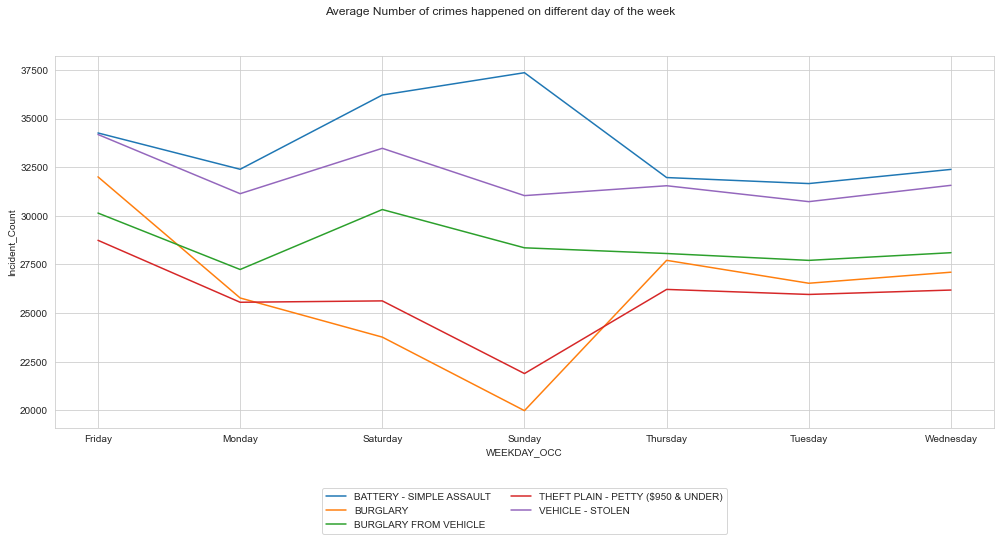

In [39]:
data_weekdayvscrimes = top_5_crimes.groupby(['WEEKDAY_OCC', 'CRM_CD_DESC']).size().reset_index(name='Incident_Count')

sns.set_style("whitegrid")
fig, ax = plt.subplots(figsize=(14, 8))


ax = sns.lineplot(x='WEEKDAY_OCC', y='Incident_Count', data=data_weekdayvscrimes, hue='CRM_CD_DESC')


ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2) 

plt.suptitle('Average Number of crimes happened on different day of the week')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

Regardless "Battery - simple assult" has highest incidents from the past 12 years,the trend is not consistent in recent years. On the other hands, "Assult with deadly weapon" incidents are  heading to upward trends among the other crimes.


array([[<AxesSubplot:xlabel='DATE_OCC'>, <AxesSubplot:xlabel='DATE_OCC'>],
       [<AxesSubplot:xlabel='DATE_OCC'>, <AxesSubplot:xlabel='DATE_OCC'>],
       [<AxesSubplot:xlabel='DATE_OCC'>, <AxesSubplot:xlabel='DATE_OCC'>]],
      dtype=object)

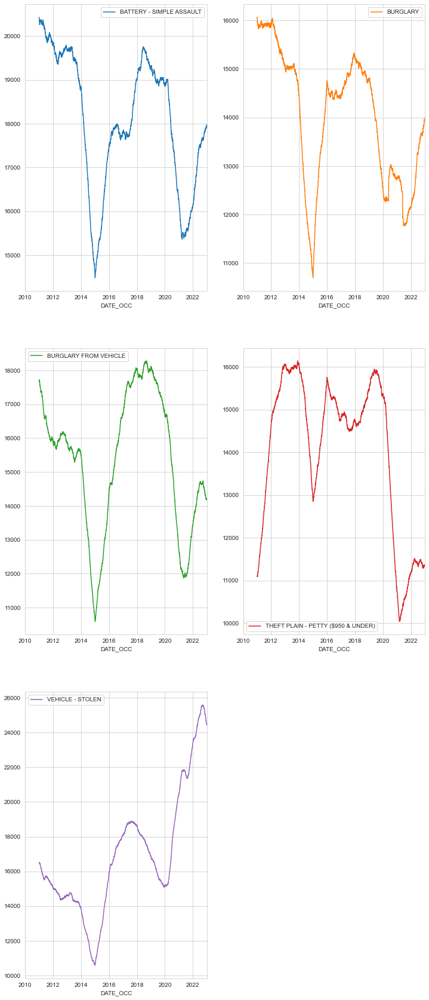

In [40]:
crimes_count_date = top_5_crimes.pivot_table('ID',aggfunc=np.size, columns='CRM_CD_DESC', index=top_5_crimes['DATE_OCC'], fill_value=0)
crimes_count_date.index = pd.DatetimeIndex(crimes_count_date.index)
crimes_count_date.rolling(365).sum().plot(figsize=(12, 30), subplots=True, layout=(-1, 2), sharex=False, sharey=False)


### 2.3 Area & Location 

Lets see distrubution based on crime area within LA county. It indicates that 77th Street is the highest crime rate and Foothill has the lowest crime rate.

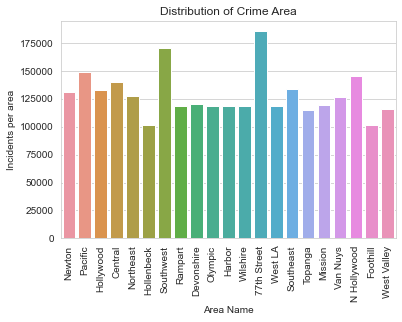

In [41]:
# Countplot for a categorical variable 
sns.countplot(data=crimedata, x='AREA_NAME')
plt.xticks(rotation=90)
plt.xlabel('Area Name')
plt.ylabel('Incidents per area')
plt.title('Distribution of Crime Area')
plt.show()

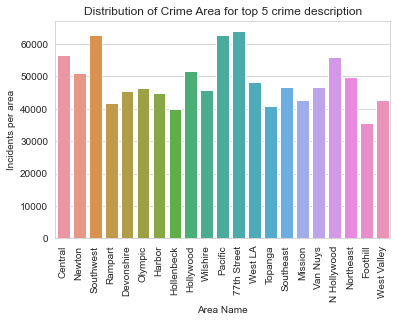

In [42]:
sns.countplot(data=top_5_crimes, x='AREA_NAME')
plt.xticks(rotation=90)
plt.xlabel('Area Name')
plt.ylabel('Incidents per area')
plt.title('Distribution of Crime Area for top 5 crime description')
plt.show()

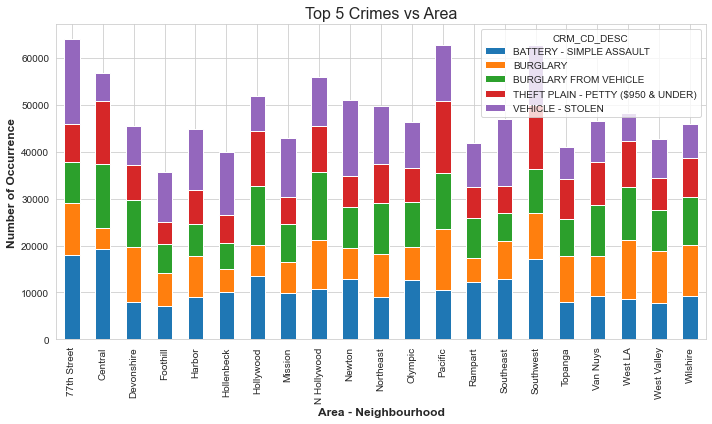

In [43]:
crime_type_by_area = top_5_crimes.groupby(['AREA_NAME', 'CRM_CD_DESC']).count().sort_values(by="ID", ascending=False)

crime_type_by_area = crime_type_by_area.reset_index()
crime_type_by_area.pivot(index='AREA_NAME', columns='CRM_CD_DESC', values='ID').plot(kind='bar', stacked=True, figsize=(10,6))
plt.xlabel('Area - Neighbourhood', fontsize=12, fontweight='bold')
plt.ylabel('Number of Occurrence', fontsize=12, fontweight='bold')
plt.title('Top 5 Crimes vs Area', fontsize=16)
plt.tight_layout()

<b>How is the outlook of location distrubution based on coordinate ? </b>

In [44]:
import requests

api_url = "https://services5.arcgis.com/7nsPwEMP38bSkCjy/arcgis/rest/services/LAPD_Division/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson"
response = requests.get(api_url)
data = response.json()

# Create a base map (default location and zoom set to thhttp://localhost:8888/notebooks/Documents/GitHub/DataScienceCapstone2/notebooks/Exploratory_data_analysis.ipynb#e whole world for this example)
lamap = folium.Map(location=[20, 0], zoom_start=2)

# Add the GeoJSON data to the map
folium.GeoJson(data).add_to(lamap)



# Save the map to an HTML file (optional)
lamap.save("lamap.html")


Top 5 Crime investigation based on location data</br>
Based on heatmap overview, Downtown LA area is significantly high of crime rates compared to other areas.

In [45]:
from folium.plugins import HeatMap


HeatMap(data=top_5_crimes[['latitude', 'longitude']], radius=16).add_to(lamap)

lamap

In [46]:
df_latlong_filter = top_5_crimes[(top_5_crimes["longitude"] <= 180) & (top_5_crimes["longitude"] >= -180) & (top_5_crimes["latitude"] <= 90) & (top_5_crimes["latitude"] >= -90)]
longitude = df_latlong_filter["longitude"]
latitude = df_latlong_filter["latitude"]

print(df_latlong_filter["longitude"].min())
print(df_latlong_filter["longitude"].max())

print(df_latlong_filter["latitude"].min())
print(df_latlong_filter["latitude"].max())

-118.8279
0.0
0.0
34.7907


### 3.Feature Correlation Heatmap


If 2 variables are correlated to each other by:</br>
0.0 to 0.3, they are weakly correlated,</br>
0.3 to 0.6, they are moderately correlated,</br>
0.6 to 0.9, they are strongly correlated,</br>
finally, >0.9, they are very strongly correlated

<b>Lets see Generic Correlation on crime data </b></br>

Pivot dataframe based on top 5 crime description.

In [49]:
pvdf_top_5_crimes = top_5_crimes.pivot_table(index=['YEAR_OCC', 'MTH_OCC', 'WEEKDAY_OCC', 'AREA_NAME'], columns=top_5_crimes['CRM_CD_DESC'], values='ID', aggfunc='sum').reset_index()
pvdf_top_5_crimes.head(3)

CRM_CD_DESC,YEAR_OCC,MTH_OCC,WEEKDAY_OCC,AREA_NAME,BATTERY - SIMPLE ASSAULT,BURGLARY,BURGLARY FROM VEHICLE,THEFT PLAIN - PETTY ($950 & UNDER),VEHICLE - STOLEN
0,2010,1,Friday,77th Street,1551013.0,886389.0,660343.0,622810.0,575859.0
1,2010,1,Friday,Central,72207.0,73225.0,2408.0,2900.0,367.0
2,2010,1,Friday,Devonshire,683828.0,688140.0,1074754.0,390898.0,523141.0


In [50]:
# Make a pairplot of the top 10 crime data
#plt.figure(figsize=(40,20))
#sns.pairplot(pvdf_top_5_crimes)
#plt.show()

In [51]:
# Make a pairplot of the top  10 crime data
top_5_crimes_matrix =pvdf_top_5_crimes.corr()
top_5_crimes_matrix

CRM_CD_DESC,YEAR_OCC,MTH_OCC,BATTERY - SIMPLE ASSAULT,BURGLARY,BURGLARY FROM VEHICLE,THEFT PLAIN - PETTY ($950 & UNDER),VEHICLE - STOLEN
CRM_CD_DESC,,,,,,,
YEAR_OCC,1.000000,0.000266,0.690014,0.629920,0.596085,0.612451,0.765139
MTH_OCC,0.000266,1.000000,0.020431,0.019009,-0.001778,0.027347,0.033175
BATTERY - SIMPLE ASSAULT,0.690014,0.020431,1.000000,0.409539,0.595453,0.584060,0.582699
BURGLARY,0.629920,0.019009,0.409539,1.000000,0.473402,0.519757,0.464237
BURGLARY FROM VEHICLE,0.596085,-0.001778,0.595453,0.473402,1.000000,0.610182,0.408932
THEFT PLAIN - PETTY ($950 & UNDER),0.612451,0.027347,0.584060,0.519757,0.610182,1.000000,0.402621
VEHICLE - STOLEN,0.765139,0.033175,0.582699,0.464237,0.408932,0.402621,1.000000


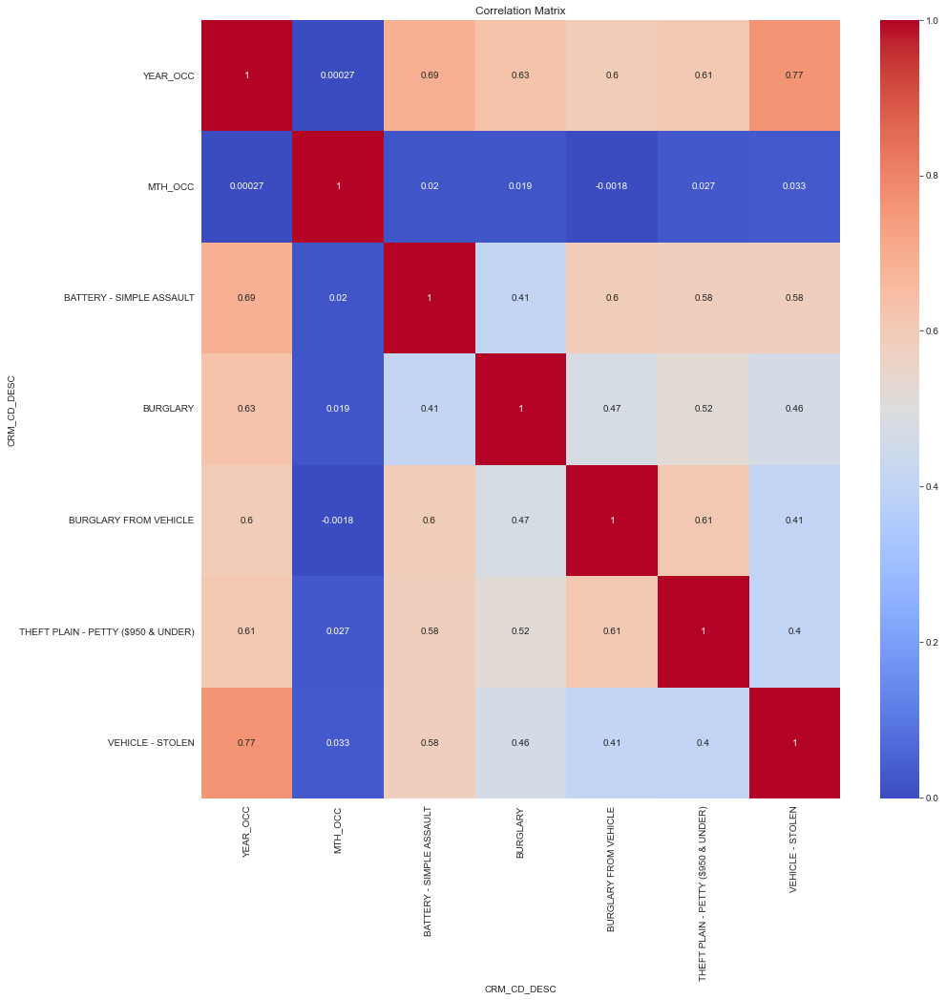

In [52]:
# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(15, 15))
sns.heatmap(top_5_crimes_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [53]:
dayofweek_by_area = top_5_crimes.pivot_table(values='ID', index='AREA_NAME', columns=top_5_crimes['WEEKDAY_OCC'], aggfunc=np.size).fillna(0)
dayofweek_by_area.head(3)

WEEKDAY_OCC,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
AREA_NAME,,,,,,,
77th Street,9618,9223,9122,8841,8982,9052,9087
Central,8927,7536,9209,7967,7893,7536,7682
Devonshire,7352,6331,6331,5682,6774,6381,6659


In [54]:
dayofweek_by_crime = top_5_crimes.pivot_table(values='ID', index='CRM_CD_DESC', columns=top_5_crimes['WEEKDAY_OCC'], aggfunc=np.size).fillna(0)
dayofweek_by_crime.head(3)

WEEKDAY_OCC,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
CRM_CD_DESC,,,,,,,
BATTERY - SIMPLE ASSAULT,34264,32397,36215,37363,31971,31662,32390
BURGLARY,32007,25779,23766,19985,27714,26536,27104
BURGLARY FROM VEHICLE,30145,27243,30326,28358,28065,27712,28107


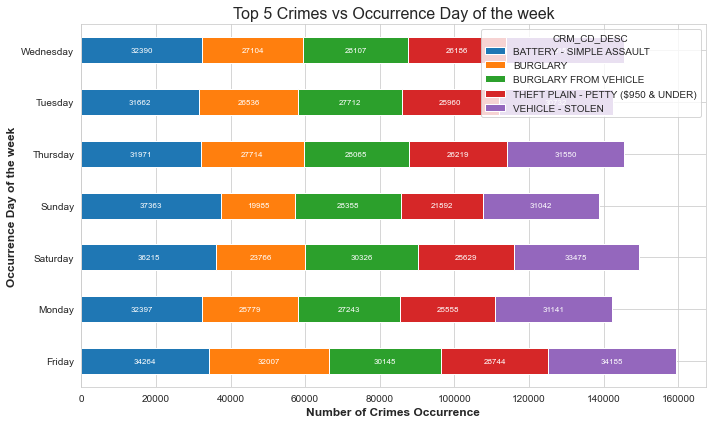

In [55]:


crime_by_dayofweek = top_5_crimes.groupby(['WEEKDAY_OCC', 'CRM_CD_DESC']).count().sort_values(by="ID", ascending=False)
crime_by_dayofweek = crime_by_dayofweek.reset_index()

pivot_table = crime_by_dayofweek.pivot(index='WEEKDAY_OCC', columns='CRM_CD_DESC', values='ID')
ax = pivot_table.plot(kind='barh', stacked=True, figsize=(10, 6))

for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{int(width)}', (x + width/2, y + height/2), ha='center', va='center', fontsize=8, color='white')

plt.xlabel('Number of Crimes Occurrence', fontsize=12, fontweight='bold')
plt.ylabel('Occurrence Day of the week', fontsize=12, fontweight='bold')
plt.title('Top 5 Crimes vs Occurrence Day of the week', fontsize=16)
plt.tight_layout()

plt.show()

In [56]:
area_by_crime  = top_5_crimes.pivot_table(values='ID', index='AREA_NAME', columns=top_5_crimes['CRM_CD_DESC'], aggfunc=np.size).fillna(0)
area_by_crime.head(3)

CRM_CD_DESC,BATTERY - SIMPLE ASSAULT,BURGLARY,BURGLARY FROM VEHICLE,THEFT PLAIN - PETTY ($950 & UNDER),VEHICLE - STOLEN
AREA_NAME,,,,,
77th Street,18007,11004,8810,8069,18035
Central,19276,4477,13586,13378,6033
Devonshire,8073,11570,10126,7458,8283


Making wrapper functions to make some minimal preprocessing and make the heatmap visualization. It is to make heatmaps nicer looking is to use a clustering algorithm to sort the rows into meaningful groups and use group labels to re-sort our matrix.

In [57]:

def scale_df(df,axis=0):
    '''
    A utility function to scale numerical values (z-scale) to have a mean of zero
    and a unit variance.
    '''
    return (df - df.mean(axis=axis)) / df.std(axis=axis)

def plot_hmap(df, ix=None, cmap='bwr'):
    '''
    A function to plot heatmaps that show temporal patterns
    '''
    if ix is None:
        ix = np.arange(df.shape[0])
    plt.imshow(df.iloc[ix,:], cmap=cmap)
    plt.colorbar(fraction=0.03)
    plt.yticks(np.arange(df.shape[0]), df.index[ix])
    plt.xticks(np.arange(df.shape[1]))
    plt.grid(False)
    plt.show()
    
    
def normalize(df):
    result = df.copy()
    for feature_name in df.columns:
        max_value = df[feature_name].max()
        min_value = df[feature_name].min()
        result[feature_name] = (df[feature_name] - min_value) / (max_value - min_value)
    return result

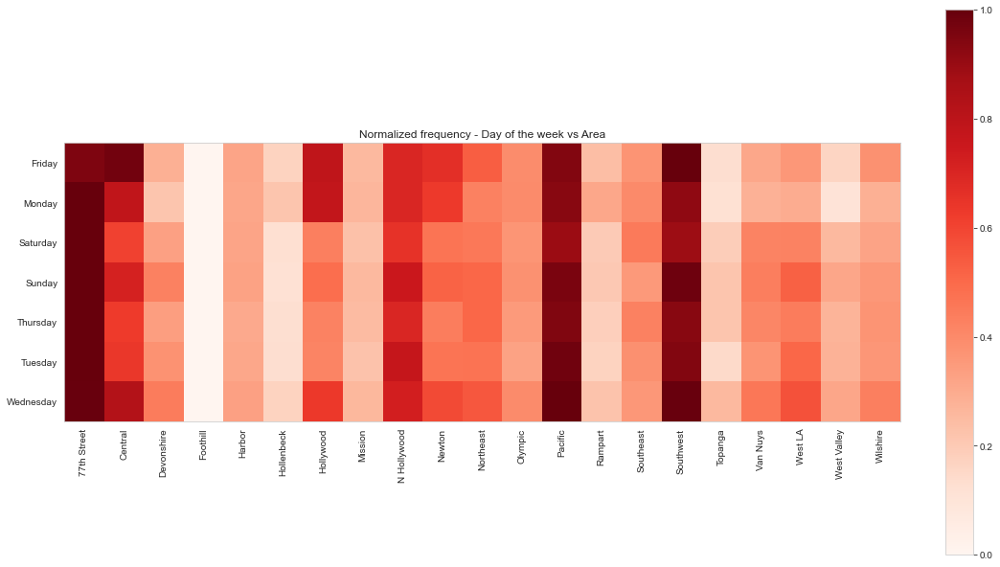

In [58]:
df = normalize(dayofweek_by_area)
ix = AC(3).fit(df.T).labels_.argsort() # a trick to make better heatmaps
plt.figure(figsize=(17,13))
plt.imshow(df.T.iloc[ix,:], cmap='Reds')
plt.colorbar(fraction=0.03)
plt.xticks(np.arange(df.shape[0]), df.index, rotation='vertical')
plt.yticks(np.arange(df.shape[1]), df.columns)
plt.title('Normalized frequency - Day of the week vs Area')
plt.grid(False)
plt.show()


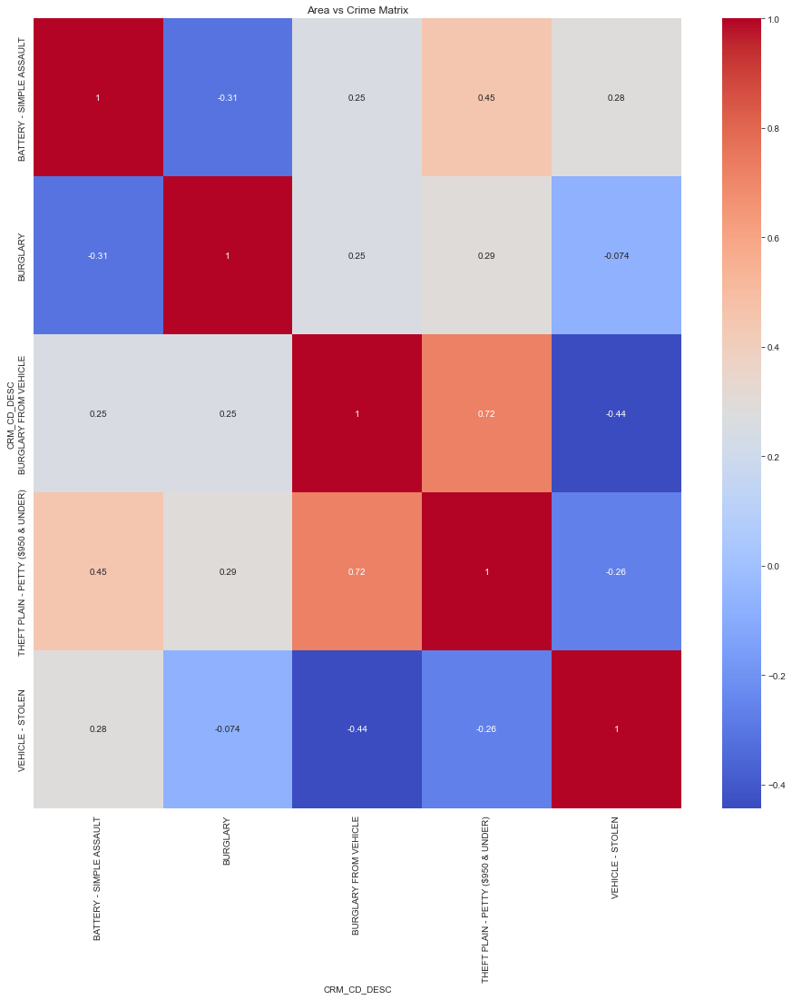

In [59]:
# Calculate Pearson correlation matrix
corr_area_by_crime = area_by_crime.corr()

# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(16, 16))
sns.heatmap(corr_area_by_crime, annot=True, cmap='coolwarm')
plt.title('Area vs Crime Matrix')
plt.show()

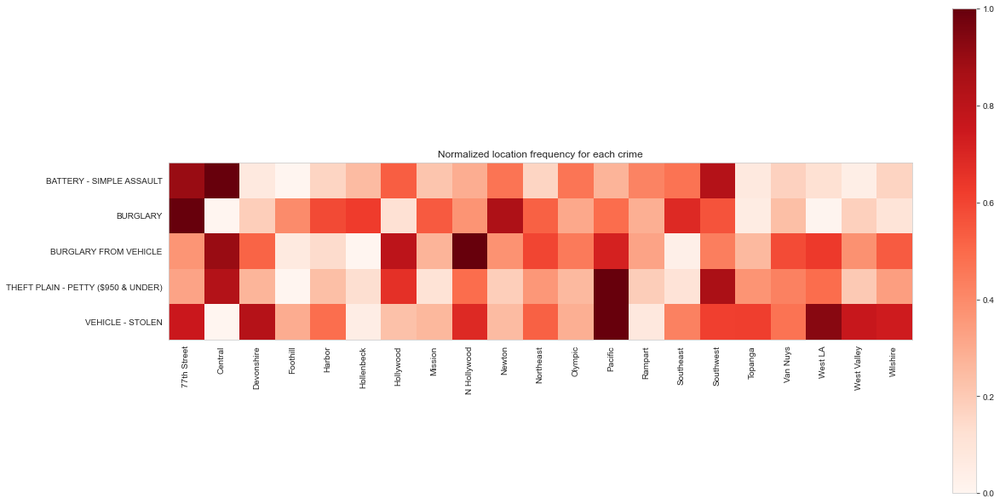

In [60]:
df = normalize(area_by_crime)
ix = AC(3).fit(df.T).labels_.argsort() # a trick to make better heatmaps
plt.figure(figsize=(17,13))
plt.imshow(df.T.iloc[ix,:], cmap='Reds')
plt.colorbar(fraction=0.03)
plt.xticks(np.arange(df.shape[0]), df.index, rotation='vertical')
plt.yticks(np.arange(df.shape[1]), df.columns)
plt.title('Normalized location frequency for each crime')
plt.grid(False)
plt.show()

Taking each crime type and re-normalize its location frequency to be between zero and one. This way, we can look at the top frequent locations of each crime type (darker red reflect a more frequent location).

### Save Data

In [61]:
top_5_crimes.shape

(1022993, 19)

In [62]:
# Specify the file path where you want to save the CSV file
file_path = "../data/interim/" + "top_5_crime_data.csv"

# Save the DataFrame to a CSV file
top_5_crimes.to_csv(file_path, index=False)  # Set index=False to exclude the DataFrame index in the CSV file

### Summary

This ends the EDA of top 5 freqent crimes over 12 years and the charts, numbers, and data indicate some of the crimes have been reported an upward trend, some are downword. But , Downtown LA (77th Street) area is all-time-high crime rate consistantly.</br>
Future Work:</br>
the crime rate trend of top 5 frequent crime type will be predicted and investigated the relationships between  feature categories such as the area ,crime type and victim descent and the crime rate.